#### Meher Shashwat Nigam,20171062

In [1]:
# Basic imports 
import cv2
import numpy as np
import matplotlib.pyplot as  plt
import os
%matplotlib inline

Link to all images:
https://drive.google.com/drive/folders/11DtJaADfhnldGrxGzOb4EhQC7y3NHQra?usp=sharing

# Question 1: Image Mosaicing

## 1.1 Feature detector/descriptor, feature matching functions

### ORB Feature detector 
ORB is basically a fusion of FAST keypoint detector and BRIEF descriptor with many modifications to enhance the performance. First it use FAST to find keypoints, then apply Harris corner measure to find top N points among them. It also use pyramid to produce multiscale-features. 

### Brute Force feature matching 
It takes the descriptor of one feature in first set and is matched with all other features in second set using some distance calculation. And the closest one is returned.

In [2]:
# Computing ORB features for a given list of images
def ORB_features(imlist):
    orb = cv2.ORB_create()
   
    kp_list = []
    des_list = []
    
    for im in imlist:
        gray = cv2.cvtColor(im, cv2.COLOR_RGB2GRAY)
        kp, des = orb.detectAndCompute(gray,None)
        kp_list.append(kp)
        des_list.append(des)
    
    return kp_list, des_list

# Get specified number of matches between both images using BF matcher(Brute force matcher)
def feature_matching(img_list,num_matches):
    bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=True)
    # Get ORB features     
    kp_list, des_list = ORB_features(img_list)
    # Match descriptors.
    matches = bf.match(des_list[0],des_list[1])
    # Sort them in the order of their distance.
    matches = sorted(matches, key = lambda x:x.distance)[:num_matches]
            
    draw_params = dict(matchesMask=None,
                       singlePointColor=None,
                       matchColor=(0, 255, 0),
                       flags=2)
    
    img = cv2.drawMatches(img_list[0],kp_list[0],img_list[1],kp_list[1],matches,None, **draw_params)
    fig = plt.figure(figsize=(16,16))
    plt.axis('off')
    plt.imshow(img)  
    plt.show()
    
    return matches,kp_list,des_list

## 1.2 Calculating the Homography

![title](images/output/homography.png)

In [3]:
def homography(cor_list):
    matrix = []
    for cor in cor_list:
        
        x1 = cor[0]
        x2 = cor[1]       
        
        row1 = [-x1[0],-x1[1],-1,0,0,0, x2[0] * x1[0], x2[0] * x1[1], x2[0] ]
        row2 = [0, 0, 0, -x1[0], -x1[1], -1, x2[1] *x1[0] , x2[1]*x1[1] , x2[1] ]

        matrix.append(row1)
        matrix.append(row2)
        
    matrix = np.array(matrix)
    u, s, Vh = np.linalg.svd(matrix)
    
    H = Vh[-1,:] / Vh[-1,-1]
    H = H.reshape((3,3))
    return H

# Calculating the homography error by projecting
# one point into the others frame and checking against ground truth
def homography_error(p1,p2,H):
    p1 = np.array([p1[0],p1[1],1]).T
    p2 = np.array([p2[0],p2[1],1]).T
    
    proj_p1 = np.dot(H,p1)
    proj_p1 = proj_p1/proj_p1[2]
    
    return np.linalg.norm(p2-proj_p1)   

def RANSAC(src_pts,dst_pts,iters,threshold,sample_size=4):
    ''' threshold : error value below which the point classifies as an inlier
        iters : number of times points are sampled and checked
    '''
    num_pts = len(src_pts)
    max_inliers = 0
    H_best = np.zeros((3,3))
    
    for i in range(iters):
        sampling = np.random.choice(num_pts,sample_size)
        
        cor_list = []
        for s in sampling:
            cor_list.append((src_pts[s,0,:], dst_pts[s,0,:] ))

        H = homography(cor_list)
        
        inliers = 0
        sum_err = 0
        
        for j in range(num_pts):
            
            err = homography_error( src_pts[j,0,:], dst_pts[j,0,:] , H)

            if(err<threshold):
                inliers+=1
                
        if inliers>max_inliers:
            max_inliers = inliers
            H_best = H
            
    return H_best,max_inliers  

# Calculate homography from given matches, by taking specified number of best matches
# and calling RANSAC for robust estimation
def calculate_homography(matches,kp_list,num_matches):
    
    if len(matches) < num_matches:
        return None
    best_matches = matches[0:num_matches]
    src_pts = np.float32([ kp_list[0][m.queryIdx].pt for m in best_matches ]).reshape(-1,1,2)
    dst_pts = np.float32([ kp_list[1][m.trainIdx].pt for m in best_matches ]).reshape(-1,1,2)
    H = RANSAC(src_pts, dst_pts,500,10)  
    return H

## 1.3 Getting the transformation 
Obtaining the transformation matrix (homography) to take one image to the other's reference frame.

In [4]:
def get_transformation(img_list):
    # Feature matching    
    matches,kp_list,des_list =  feature_matching(img_list,30)
    # Homography
    H,_ = calculate_homography(matches,kp_list,30)
    return H

## 1.4 Performing the image stitching

Perform stitching by transforming the second image into the first image's frame and putting the first image as it is.

Further remove black regions around the final stitched image.

In [5]:

def stitching(img_list,H,size):
    h,w,c = img_list[0].shape
    dst = cv2.warpPerspective(img_list[1],np.linalg.inv(H),size)
    dst[0 : h , 0: w,:] = img_list[0]
    return dst

# Remove black region around the image after stitching
def remove_black(frame):
    #crop top
    if not np.sum(frame[0]):
        return remove_black(frame[1:])
    #crop bottom
    elif not np.sum(frame[-1]):
        return remove_black(frame[:-2])
    #crop left
    elif not np.sum(frame[:,0]):
        return remove_black(frame[:,1:]) 
    #crop right
    elif not np.sum(frame[:,-1]):
        return remove_black(frame[:,:-2])    
    return frame

### Test Image 1

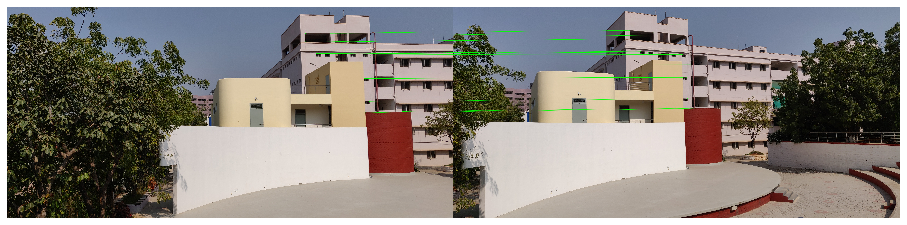

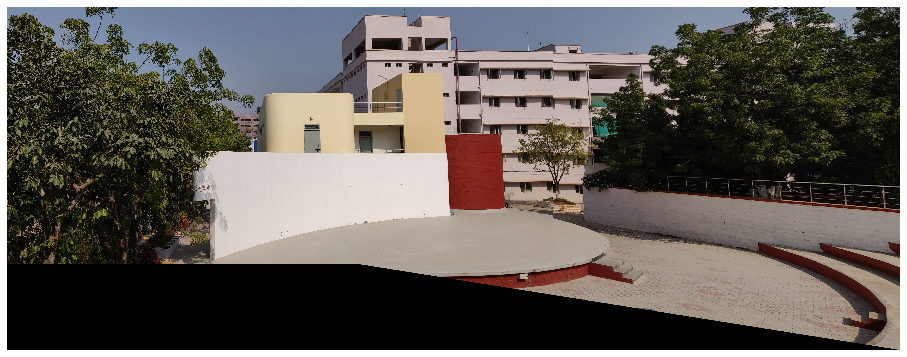

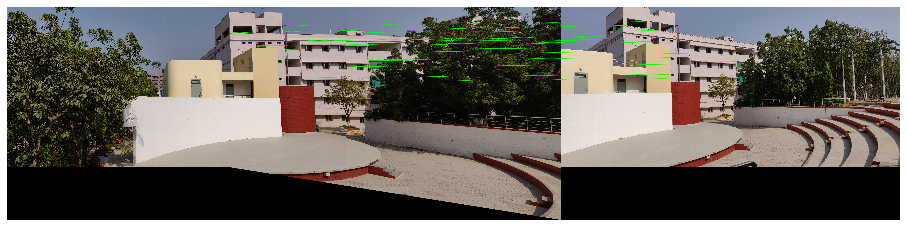

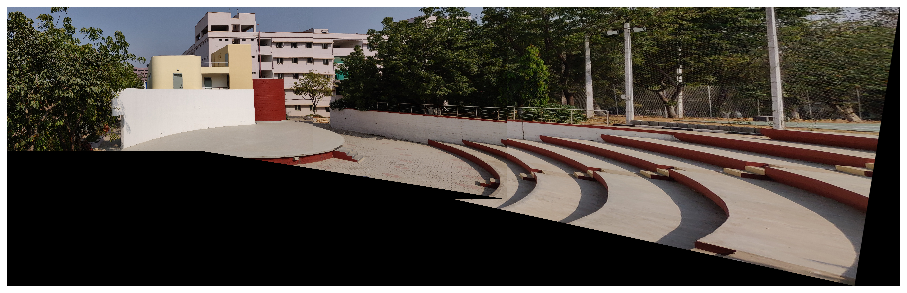

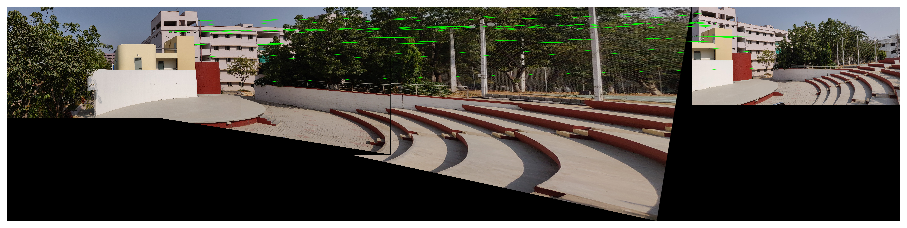

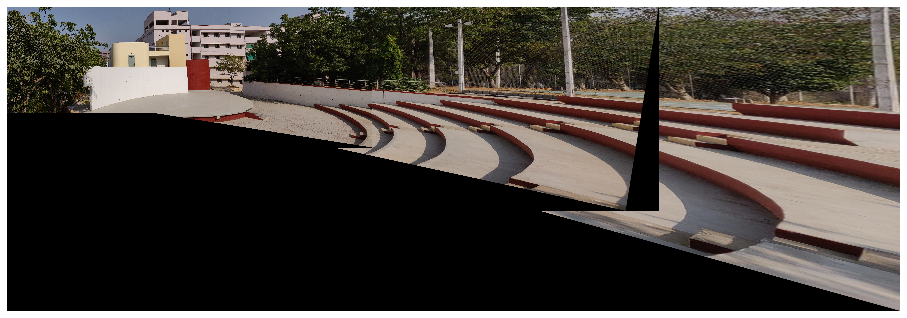

In [6]:
# Load images
img_list = []

for i in range(1,5):
    im = cv2.cvtColor( cv2.imread(os.path.join('./images/image_mosaicing/img1_{}.jpg'.format(i))),cv2.COLOR_BGR2RGB)   
    img_list.append(im)
h,w,c = img_list[0].shape

H = get_transformation(img_list[:2])
final_img = stitching(img_list[:2],H,tuple([2*w,2*h]))
final_img = remove_black(final_img)
fig = plt.figure(figsize=(16,16))
plt.imshow(final_img)
plt.axis('off')
plt.show()

H = get_transformation([final_img,img_list[2]])
final_img = stitching([final_img,img_list[2]],H,tuple([3*w,3*h]))
final_img = remove_black(final_img)
fig = plt.figure(figsize=(16,16))
plt.imshow(final_img)
plt.axis('off')
plt.show()

H = get_transformation([final_img,img_list[3]])
final_img = stitching([final_img,img_list[3]],H,tuple([4*w,4*h]))
final_img = remove_black(final_img)
fig = plt.figure(figsize=(16,16))
plt.imshow(final_img)
plt.axis('off')
plt.show()

### Test Image 3

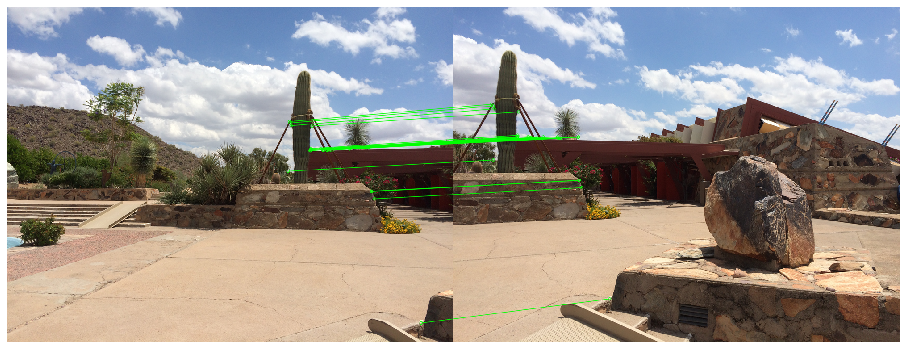

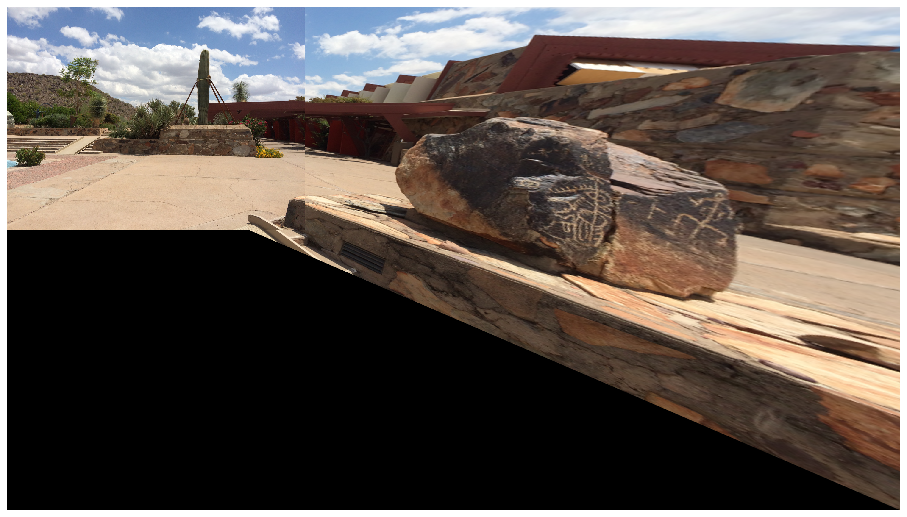

In [7]:
# Load images
img_list = []
for i in range(1,3):
    im = cv2.cvtColor( cv2.imread(os.path.join('./images/image_mosaicing/img3_{}.png'.format(i))),cv2.COLOR_BGR2RGB)   
    img_list.append(im)

h,w,c = img_list[0].shape

H = get_transformation(img_list)
final_img = stitching(img_list,H,tuple([3*w,3*h]))
final_img = remove_black(final_img)

fig = plt.figure(figsize=(16,16))
plt.imshow(final_img)
plt.axis('off')
plt.show()

### Test Image 5

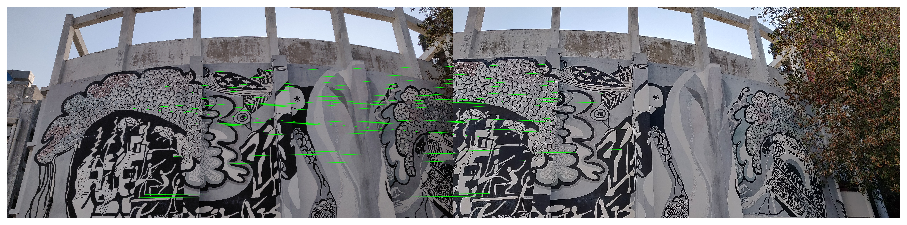

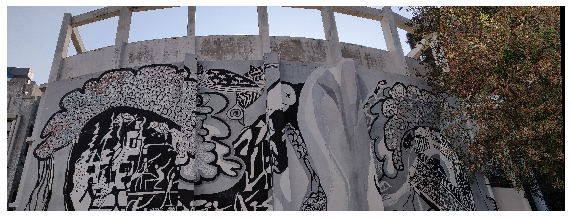

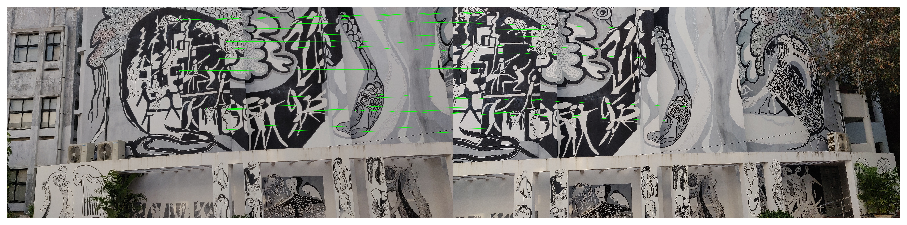

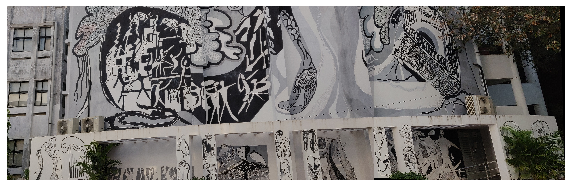

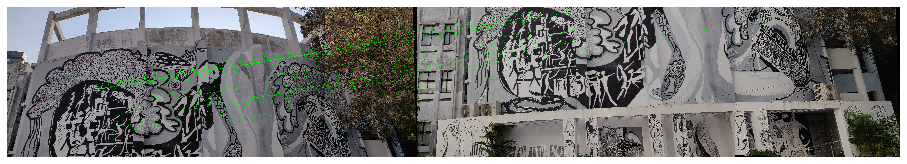

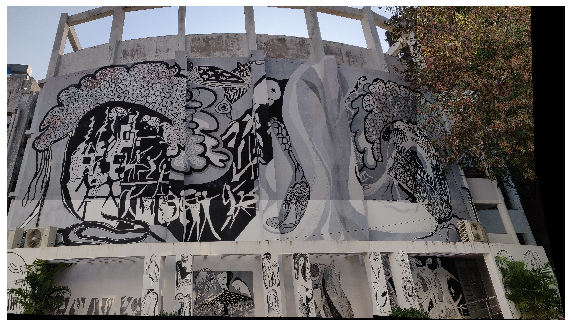

In [8]:
img_list = []
for i in range(1,5):
    im = cv2.cvtColor( cv2.imread(os.path.join('./images/image_mosaicing/img5_{}.jpg'.format(i))),cv2.COLOR_BGR2RGB)   
    img_list.append(im)
h,w,c = img_list[0].shape

H = get_transformation([img_list[0],img_list[1]])
final_img1 = stitching([img_list[0],img_list[1]],H,tuple([2*w,h]))
final_img1 = remove_black(final_img1)

fig = plt.figure(figsize=(10,10))
plt.imshow(final_img1)
plt.axis('off')
plt.show()

H = get_transformation([img_list[3],img_list[2]])
final_img2 = stitching([img_list[3],img_list[2]],H,tuple([2*w,h]))
final_img2 = remove_black(final_img2)

fig = plt.figure(figsize=(10,10))
plt.imshow(final_img2)
plt.axis('off')
plt.show()

H = get_transformation([final_img1,final_img2])
final_img = stitching([final_img1,final_img2],H,tuple([2*w,2*h]))
final_img = remove_black(final_img)
fig = plt.figure(figsize=(10,10))
plt.imshow(final_img)
plt.axis('off')
plt.show()


### Test Image 2

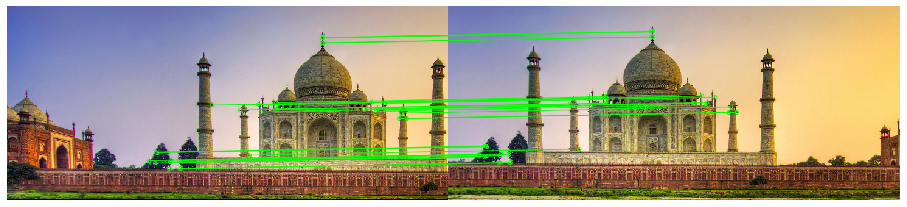

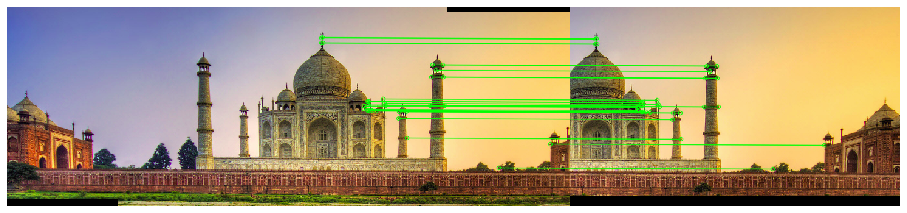

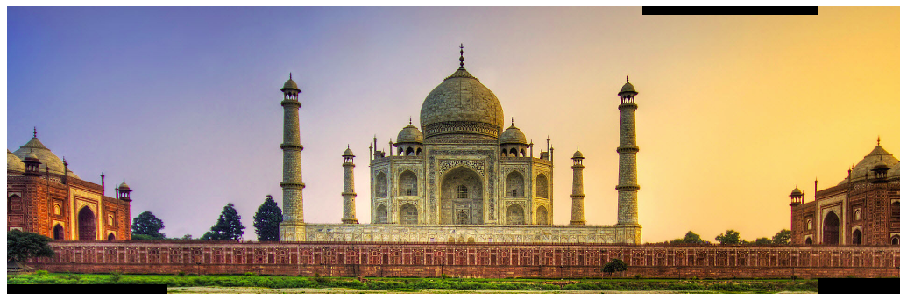

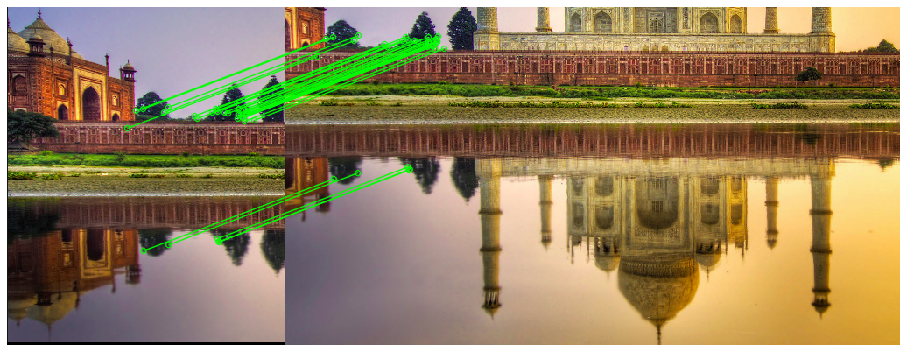

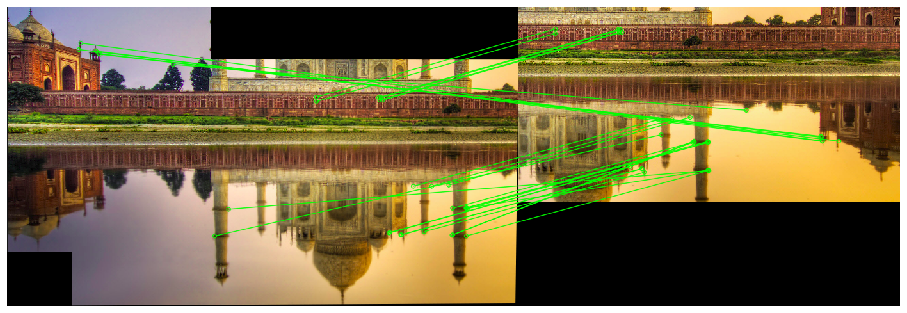

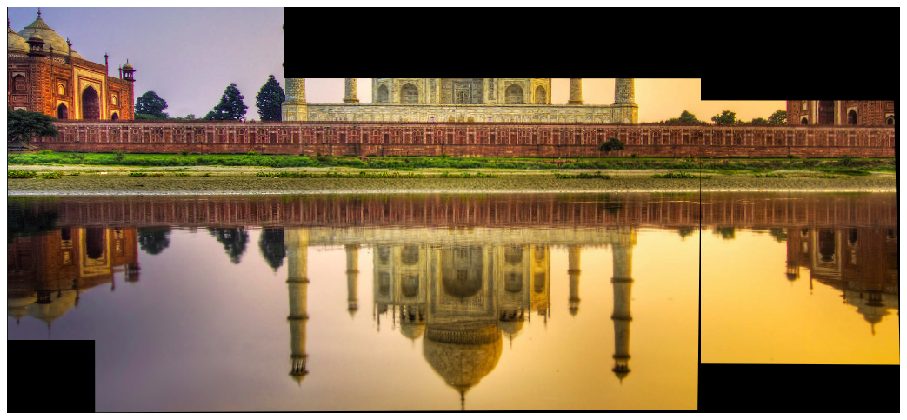

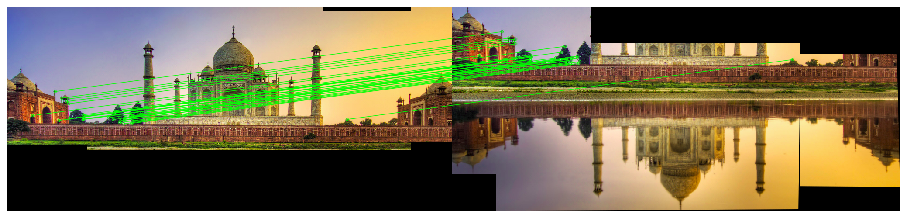

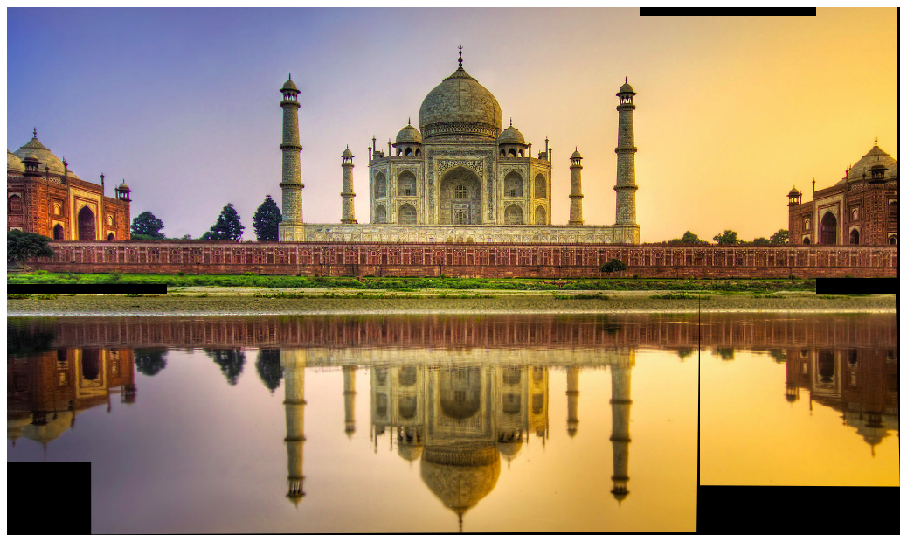

In [9]:
img_list = []
for i in range(1,7):
    im = cv2.cvtColor( cv2.imread(os.path.join('./images/image_mosaicing/img2_{}.png'.format(i))),cv2.COLOR_BGR2RGB)   
    img_list.append(im)
h,w,c = img_list[0].shape

H = get_transformation([img_list[0],img_list[1]])
final_img1 = stitching([img_list[0],img_list[1]],H,tuple([2*w,2*h]))
final_img1 = remove_black(final_img1)
H = get_transformation([final_img1,img_list[2]])
final_img1 = stitching([final_img1,img_list[2]],H,tuple([3*w,2*h]))
final_img1 = remove_black(final_img1)
fig = plt.figure(figsize=(16,16))
plt.imshow(final_img1)
plt.axis('off')
plt.show()


H = get_transformation([img_list[3],img_list[4]])
final_img2 = stitching([img_list[3],img_list[4]],H,tuple([2*w,3*h]))
final_img2 = remove_black(final_img2)
H = get_transformation([final_img2,img_list[5]])
final_img2 = stitching([final_img2,img_list[5]],H,tuple([3*w,3*h]))
final_img2 = remove_black(final_img2)
fig = plt.figure(figsize=(16,16))
plt.imshow(final_img2)
plt.axis('off')
plt.show()

H = get_transformation([final_img1,final_img2])
final_img4 = stitching([final_img1,final_img2],H,tuple([4*w,4*h]))
final_img4 = remove_black(final_img4)
fig = plt.figure(figsize=(16,16))
plt.imshow(final_img4)
plt.axis('off')
plt.show()

### Test image 4

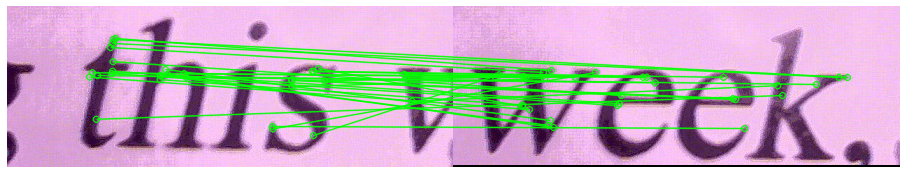

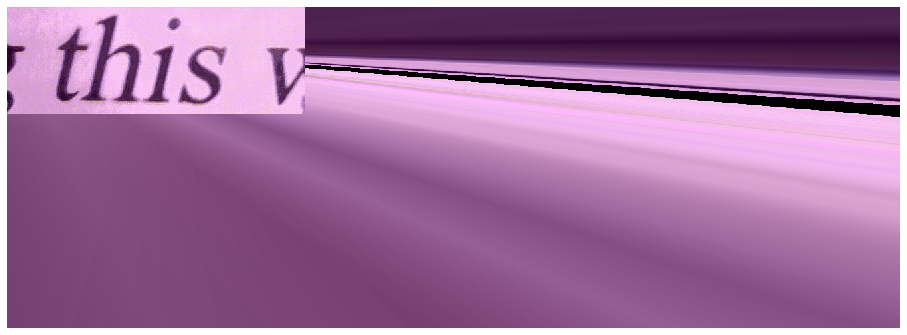

In [10]:
# Load images
img_list = []
for i in range(1,3):
    im = cv2.cvtColor( cv2.imread(os.path.join('./images/image_mosaicing/img4_{}.jpg'.format(i))),cv2.COLOR_BGR2RGB)   
    img_list.append(im)

h,w,c = img_list[0].shape

H = get_transformation(img_list)
final_img = stitching(img_list,H,tuple([3*w,3*h]))
final_img = remove_black(final_img)

fig = plt.figure(figsize=(16,16))
plt.imshow(final_img)
plt.axis('off')
plt.show()

### Test Image 6 : My image

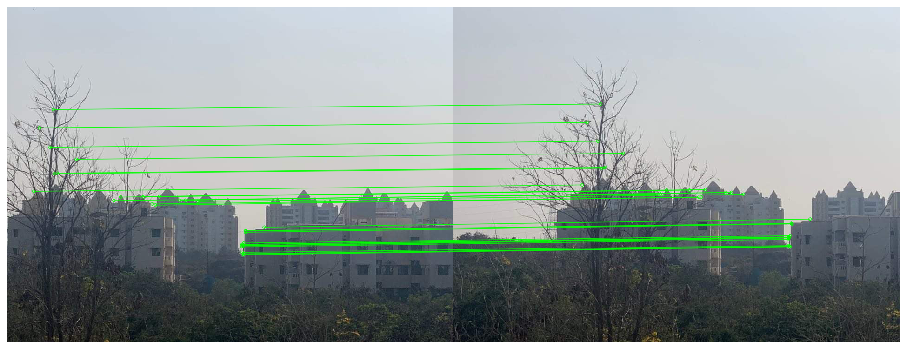

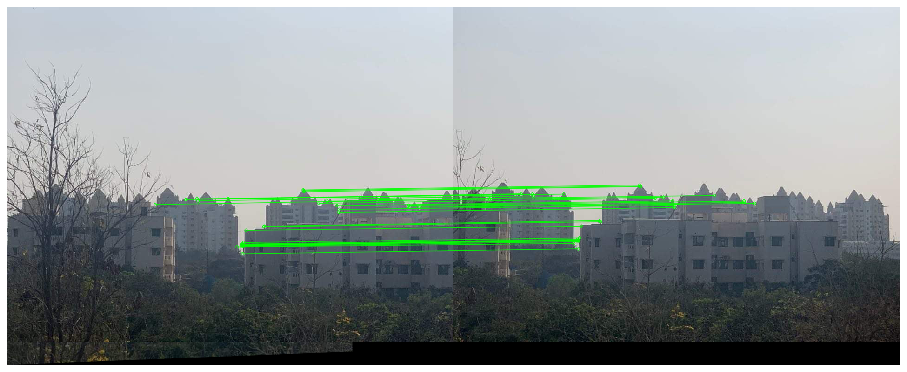

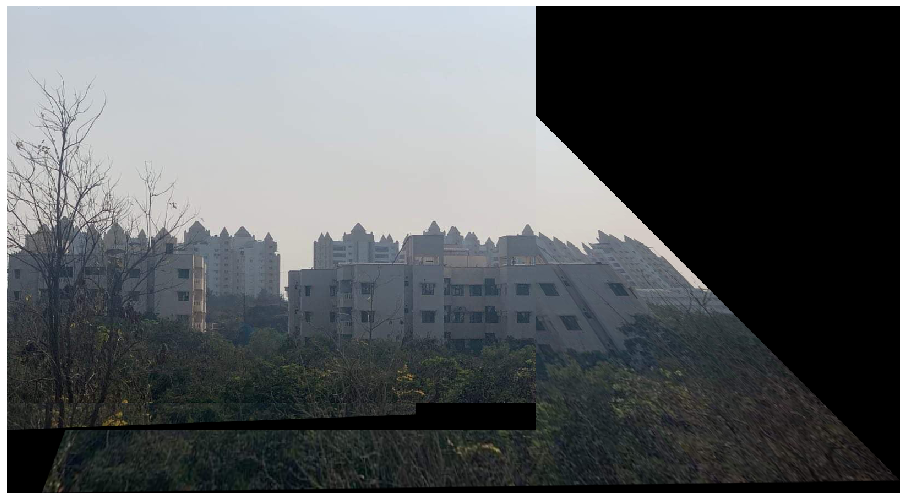

In [11]:
img_list = []
for i in range(1,4):
    im = cv2.cvtColor( cv2.imread(os.path.join('./images/image_mosaicing/img6_{}.jpg'.format(i))),cv2.COLOR_BGR2RGB)   
    img_list.append(im)
h,w,c = img_list[0].shape

H = get_transformation([img_list[1],img_list[0]])
final_img1 = stitching([img_list[1],img_list[0]],H,tuple([2*w,2*h]))
final_img1 = remove_black(final_img1)
H = get_transformation([final_img1,img_list[2]])
final_img1 = stitching([final_img1,img_list[2]],H,tuple([3*w,2*h]))
final_img1 = remove_black(final_img1)
fig = plt.figure(figsize=(16,16))
plt.imshow(final_img1)
plt.axis('off')
plt.show()


## Question 1 Bonus 1: Automatic image stitching

We can stitch images given in any order without human intervention:
### Feature Matching:
1) Extract SIFT features from all n images.
2) Find k nearest neighbours for each feature using a k-d tree.
### Image matching:
For each image:
1) Select m candidate matching images.
2) Find geometrically consistent feature matches using RANSAC to solve for homography between pair of images.
3) Verify image matches using probabilistic model.
### Finding Panaromas:
Find connected components of image patches.
### Optimization:
For each connected component:
1) Perform bundle adjustment for rotation and focal length of camera.
2) Render panaroma using multi band blending.

## Question 1 Bonus 2: Noisy images
The algorithm defined above is insensitive to noise images that are not part of a panorama, and can recognise multiple panoramas in an unordered image dataset. This is achieved by the RANSAC method which chooses inliers based on some similiarity measure and then probabilistic method is used to refine it further.

# Question 2 : Stereo Correspondences

### Helper Functions

In [12]:
# Draw matches between patches(single image)
def draw_lines(stereo_img,matches,patch_size):
    r,c,_ = stereo_img.shape
    
    for match in matches:
        color = tuple(np.random.randint(0,255,3).tolist())
        p = (match[0][1]+patch_size//2,match[0][0]+patch_size//2)
        q = (match[1][1]+patch_size//2+c//2,match[1][0]+patch_size//2)
        lined_stereo_img = cv2.line(stereo_img,p,q,color,2)
        lined_stereo_img = cv2.circle(lined_stereo_img,p,5,color,-1)
        lined_stereo_img = cv2.circle(lined_stereo_img,q,5,color,-1)
    plt.figure(figsize=(18,18))
    plt.imshow(lined_stereo_img)
    plt.axis('off')
    plt.show()
    
# Draw matches between patches(two images)
def draw_matches(img1,img2,matches,ws=0):
    r,c,_ = img1.shape
    img3 = np.zeros((r,2*c,3))
    img3[:,:c,:] = img1
    img3[:,c:,:] = img2
    
    for match in matches:
        color = tuple(np.random.randint(0,255,3).tolist())
        p = (match[0][1]+ws//2,match[0][0]+ws//2)
        q = (match[1][1]+c+ws//2,match[1][0]+ws//2)
        lined = cv2.line(img3,p,q,color,2)
        lined = cv2.circle(lined,p,5,color,-1)
        lined = cv2.circle(lined,q,5,color,-1)
    plt.figure(figsize=(18,18))
    
    plt.imshow(lined.astype(np.uint8))
    plt.axis('off')
    plt.show()

## 2.1 Intensity Window-based correlation 
We take each patch ( according to specified window size) in the first image and iterate over all patches in the second image to find the best match. 

In [13]:
# Normalized correlation function
def normcorr(a,b):
    na = a-np.mean(a)
    na = na/(np.linalg.norm(na)+1)
    nb = b-np.mean(b)
    nb = nb/(np.linalg.norm(nb)+1)    
    corr = abs(np.dot(na,nb))
    return corr

# Intensity Window-based correlation function  
def intensity_matching(img1,img2,patch_size,step,offset=0):
    r1,c1,c = img1.shape
    r2,c2,c = img2.shape
    matches = []
    for y1 in range(0,r1-patch_size+1,step):
        for x1 in range(0,c1-patch_size+1,step):
            best_diff = -1
            for y2 in range(0,r2-patch_size+1,step):
                for x2 in range(0,c2-patch_size+1,step):
                    a = img1[y1:y1+patch_size,x1:x1+patch_size,:].flatten()
                    b = img2[y2:y2+patch_size,x2:x2+patch_size,:].flatten()
                    diff = normcorr(a,b)
                    if diff>best_diff:
                        best_diff = diff
                        best_match = np.array([[x1,y1+offset],[x2,y2+offset],diff])
            matches.append(best_match)
    return matches       

### Displaying results over test images

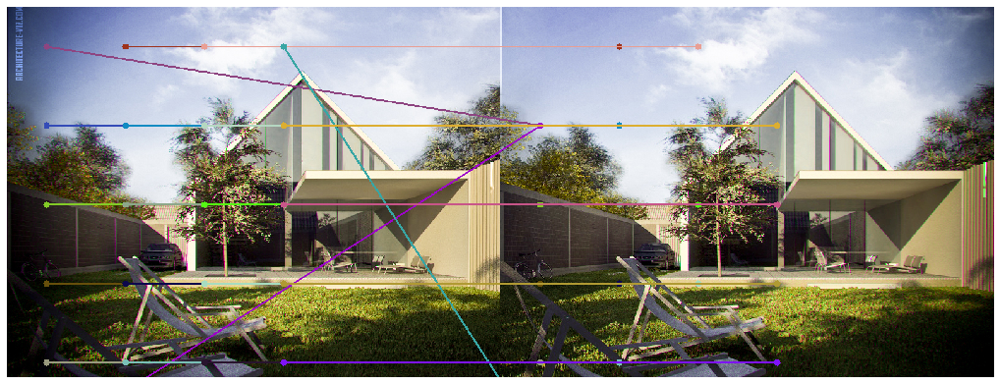

In [14]:
x = 1
img = cv2.cvtColor(cv2.imread('./images/stereo_images/'+str(x)+'.jpg'),cv2.COLOR_BGR2RGB)
h,w,c = img.shape
img1 = img[:,0:w//2,:]
img2 = img[:,w//2:w,:]

matches = intensity_matching(img1,img2,128,128)
lined_im = draw_matches(img1,img2,matches,128)

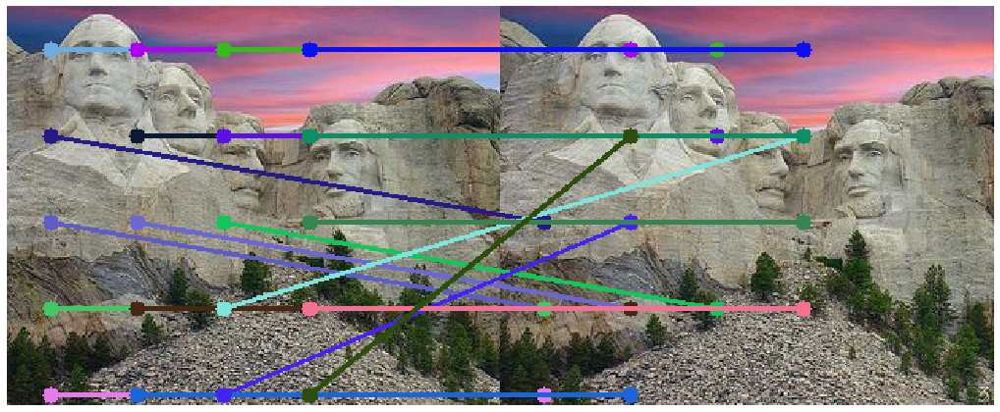

In [15]:
x = 2
img = cv2.cvtColor(cv2.imread('./images/stereo_images/'+str(x)+'.jpg'),cv2.COLOR_BGR2RGB)
h,w,c = img.shape
img1 = img[:,0:w//2,:]
img2 = img[:,w//2:w,:]

matches = intensity_matching(img1,img2,56,56)
lined_im = draw_matches(img1,img2,matches,56)

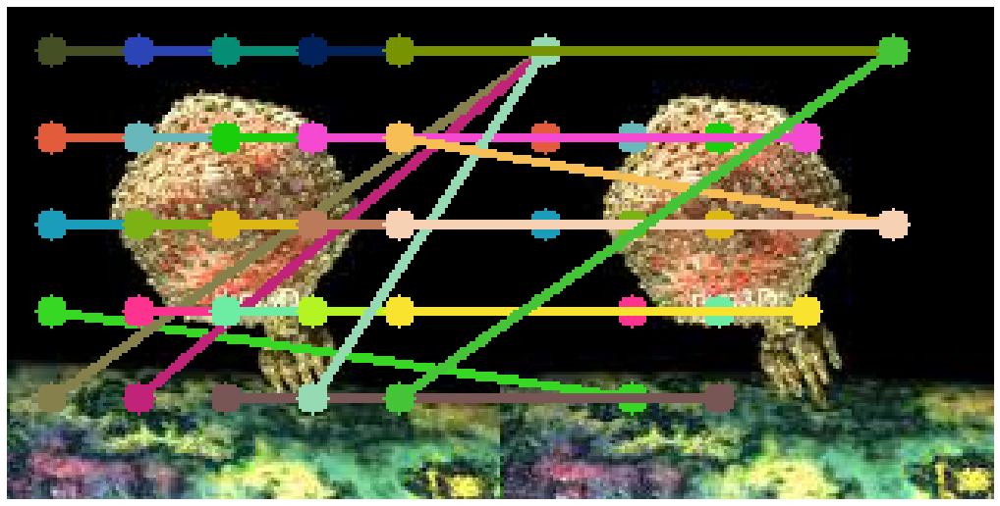

In [16]:
x = 3
img = cv2.cvtColor(cv2.imread('./images/stereo_images/'+str(x)+'.jpeg'),cv2.COLOR_BGR2RGB)
h,w,c = img.shape
img1 = img[:,0:w//2,:]
img2 = img[:,w//2:w,:]

matches = intensity_matching(img1,img2,28,28)
lined_im = draw_matches(img1,img2,matches,28)

## 2.2 Stereo Rectification
- Calculate stereo correspondences between the two images(using ORB feature matching, defined in question 1).
- Calculate the fundamental matrix for the given pair of images from the matches found.
- Project the two images to the same plane after calculating the homography for both the images(rectified).

In [17]:
def stereo_rectification(img1,img2,k):
    matches,kp_list,des_list =  feature_matching([img1,img2],k)
    best_matches = matches[0:k]
    src_pts = np.float32([ kp_list[0][m.queryIdx].pt for m in best_matches ]).reshape(-1,1,2)
    dst_pts = np.float32([ kp_list[1][m.trainIdx].pt for m in best_matches ]).reshape(-1,1,2)

    
    F, mask = cv2.findFundamentalMat(src_pts,dst_pts,cv2.RANSAC)

    src_pts = src_pts[mask.ravel()==1]
    dst_pts = dst_pts[mask.ravel()==1]
    img_size = img1.shape[0:2][::-1]
    p,H1,H2=cv2.stereoRectifyUncalibrated(src_pts,dst_pts, F, img_size)
        
    img1_corrected = cv2.warpPerspective(img1, H1, img_size)
    img2_corrected = cv2.warpPerspective(img2, H2, img_size)
    
    return img1_corrected, img2_corrected

### Testing on images

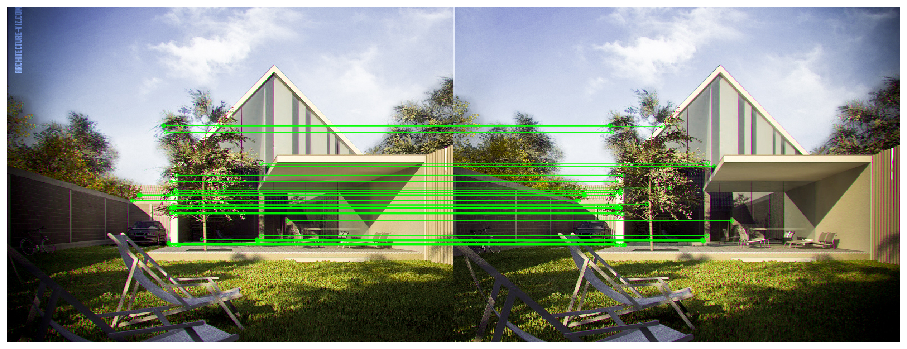

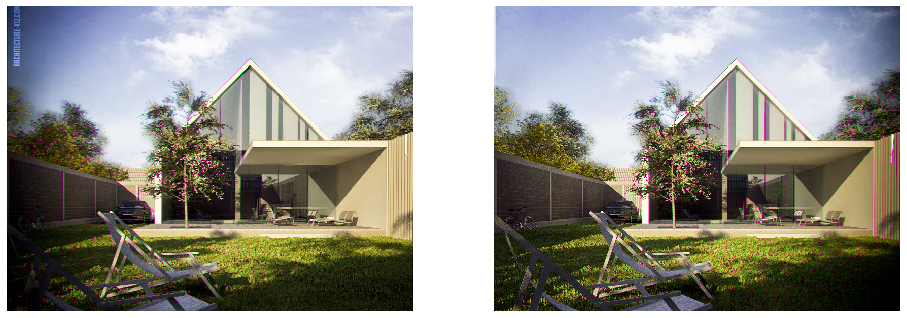

True

In [18]:
x = 1
img = cv2.cvtColor(cv2.imread('./images/stereo_images/'+str(x)+'.jpg'),cv2.COLOR_BGR2RGB)
h,w,c = img.shape
img1 = img[:,0:w//2,:]
img2 = img[:,w//2:w,:]    
im1,im2 = stereo_rectification(img1,img2,50)
fig = plt.figure(figsize=(16,16))
plt.subplot(1, 2, 1),plt.imshow(im1.astype(np.uint8))
plt.axis('off')
plt.subplot(1, 2, 2),plt.imshow(im2.astype(np.uint8))
plt.axis('off')
plt.show()
cv2.imwrite('./images/output/stereo_rect'+str(x)+'_1.jpg',im1)
cv2.imwrite('./images/output/stereo_rect'+str(x)+'_2.jpg',im2)

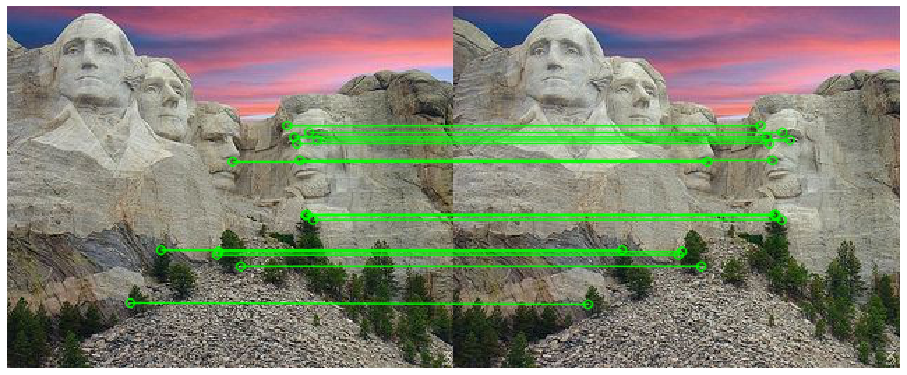

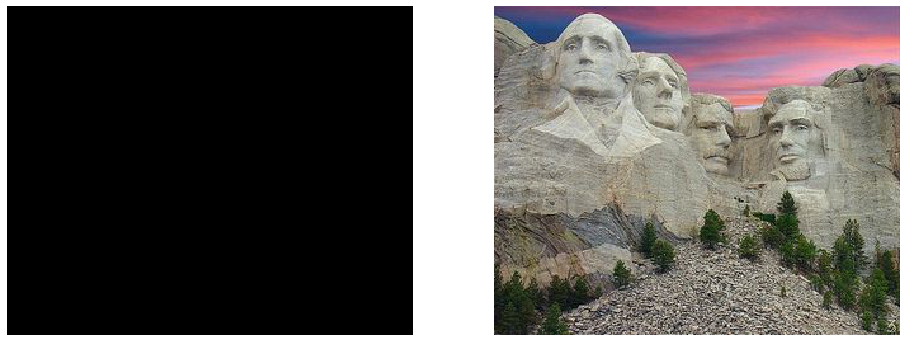

True

In [19]:
x = 2
img = cv2.cvtColor(cv2.imread('./images/stereo_images/'+str(x)+'.jpg'),cv2.COLOR_BGR2RGB)
h,w,c = img.shape
img1 = img[:,0:w//2,:]
img2 = img[:,w//2:w,:]    
im1,im2 = stereo_rectification(img1,img2,15)
fig = plt.figure(figsize=(16,16))
plt.subplot(1, 2, 1),plt.imshow(im1)
plt.axis('off')
plt.subplot(1, 2, 2),plt.imshow(im2)
plt.axis('off')
plt.show()
cv2.imwrite('./images/output/stereo_rect'+str(x)+'_1.jpg',im1)
cv2.imwrite('./images/output/stereo_rect'+str(x)+'_2.jpg',im2)

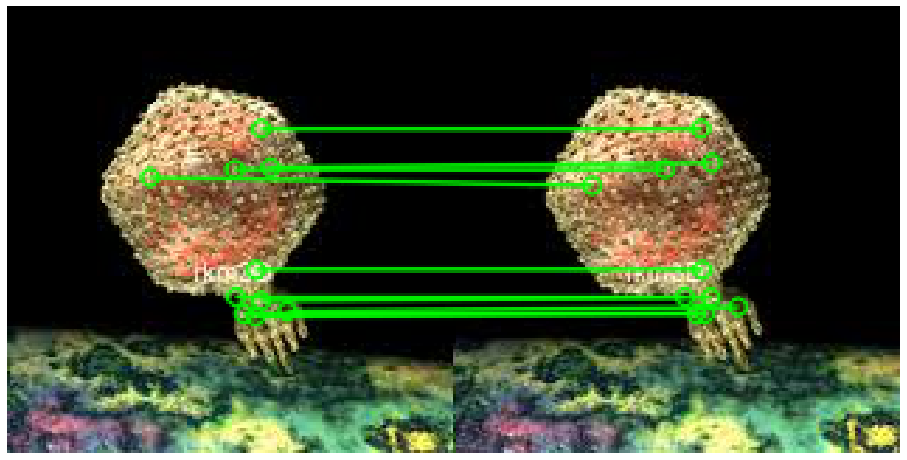

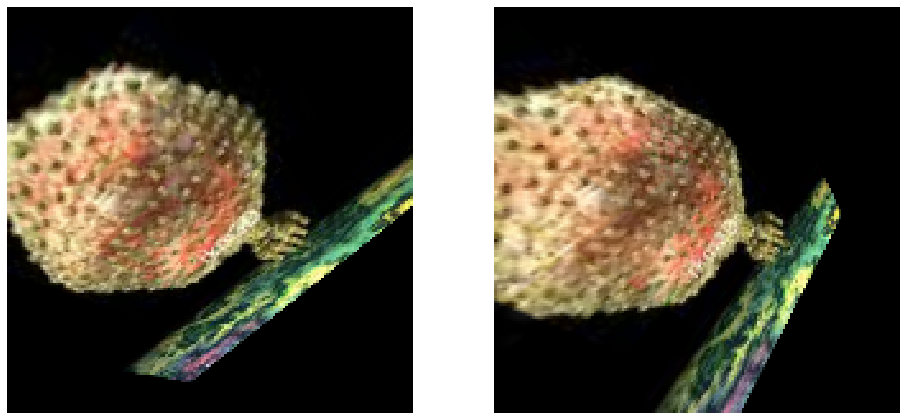

True

In [20]:
x = 3
img = cv2.cvtColor(cv2.imread('./images/stereo_images/'+str(x)+'.jpeg'),cv2.COLOR_BGR2RGB)
h,w,c = img.shape
img1 = img[:,0:w//2,:]
img2 = img[:,w//2:w,:]    
im1,im2 = stereo_rectification(img1,img2,10)
fig = plt.figure(figsize=(16,16))
plt.subplot(1, 2, 1),plt.imshow(im1)
plt.axis('off')
plt.subplot(1, 2, 2),plt.imshow(im2)
plt.axis('off')
plt.show()
cv2.imwrite('./images/output/stereo_rect'+str(x)+'_1.jpg',im1)
cv2.imwrite('./images/output/stereo_rect'+str(x)+'_2.jpg',im2)

## 2.3 Greedy matching and dynamic programming based approaches for matching on recified images

### Greedy matching 

In [21]:
# Greedy matching along epipolar lines
def greedy_matching(img1,img2,ws,stride):
    r1,c1,c = img1.shape
    r2,c2,c = img2.shape
    
    matches = []
    for y in range(0,r1-ws,stride):
        im1 = img1[y:y+ws+1,:,:]    
        im2 = img2[y:y+ws+1,:,:]    
        new_matches = intensity_matching(im1,im2,ws,stride,y)
        matches = matches + new_matches
    return matches 

### Testing on rectified images

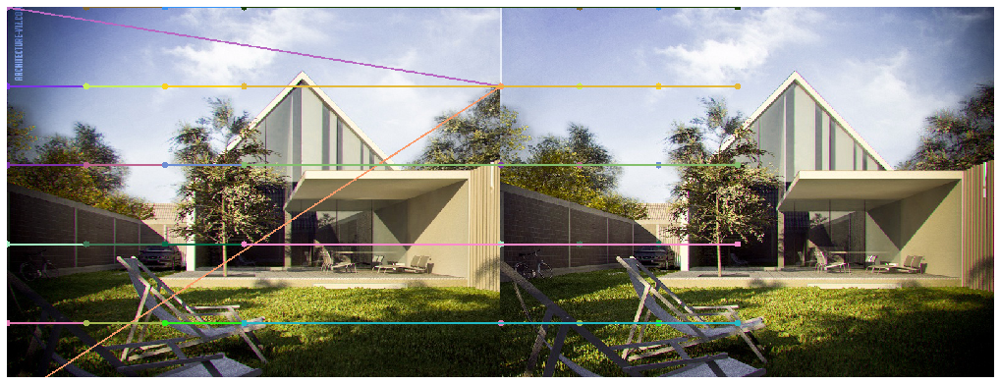

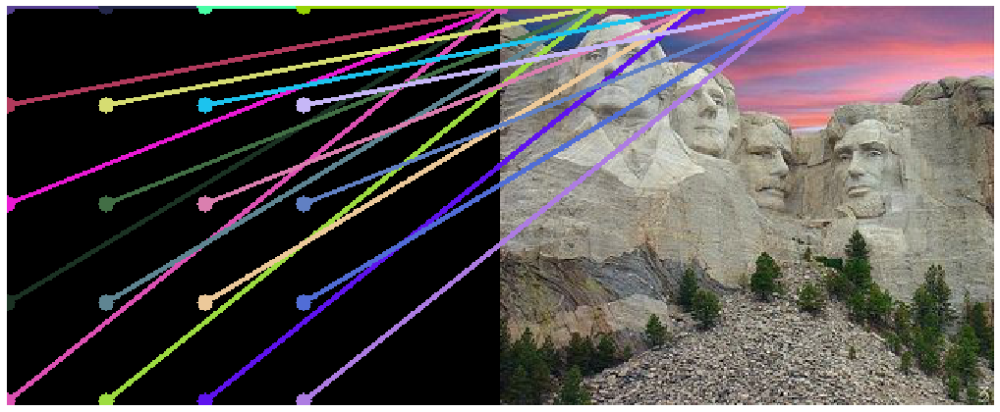

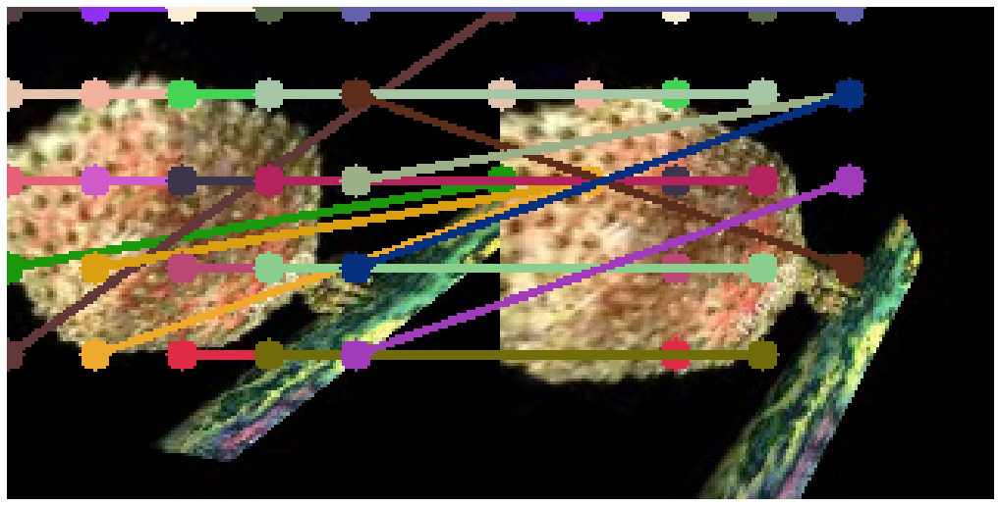

In [22]:
x=1
img1 = cv2.imread('./images/output/stereo_rect'+str(x)+'_1.jpg')
img2 = cv2.imread('./images/output/stereo_rect'+str(x)+'_2.jpg')

matches = greedy_matching(img1,img2,128,128)
lined_im = draw_matches(img1,img2,matches)

x=2
img1 = cv2.imread('./images/output/stereo_rect'+str(x)+'_1.jpg')
img2 = cv2.imread('./images/output/stereo_rect'+str(x)+'_2.jpg')

matches = greedy_matching(img1,img2,64,64)
lined_im = draw_matches(img1,img2,matches)

x=3
img1 = cv2.imread('./images/output/stereo_rect'+str(x)+'_1.jpg')
img2 = cv2.imread('./images/output/stereo_rect'+str(x)+'_2.jpg')

matches = greedy_matching(img1,img2,28,28)
lined_im = draw_matches(img1,img2,matches)

### Dynamic programming based approach using longest common subsequence
Given two epipolar lines, we have to find the matches such that occlusion does not affect the matching, thus longest common subsequence is used.
A subsequence is a sequence that can be derived from another sequence by deleting some elements without changing the order of the remaining elements. Longest common subsequence (LCS) of 2 sequences is a subsequence, with maximal length, which is common to both the sequences.
Dynamic Programming is used for solving this by storing the maximum length of subsequence till the previous index and then back tracking to find the matches.

In [23]:
def longest_common_subsequence(line1, line2,row,matches):
    dp = np.zeros((line1.shape[0]+1,line2.shape[0]+1))
    for i in range(line1.shape[0]+1):
        for j in range(line2.shape[0]+1):
            if(i==0 or j==0):
                continue
            elif (line1[i-1] == line2[j-1]): 
                dp[i,j] = 1 + dp[i-1][j-1]
            else:
                dp[i,j] = max(dp[i-1,j], dp[i,j-1])
    i = line1.shape[0]
    j = line2.shape[0]
    while (i >= 0 and j >= 0) : 
        if (line1[i-1] == line2[j-1]): 
            matches.append([[row,i-1],[row,j-1]])
            i-=1
            j-=1
      
        elif (dp[i-1,j] > dp[i,j-1]): 
            i-=1 
        else:
            j-=1
    return matches

def dpbased_matching(img1,img2,skip):
    r1,c1 = img1.shape
    r2,c2 = img2.shape
    matches = []
    for i in range(0,r1,skip):
        matches = longest_common_subsequence(img1[i],img2[i],i,matches)
    return matches   

### Testing on rectified images

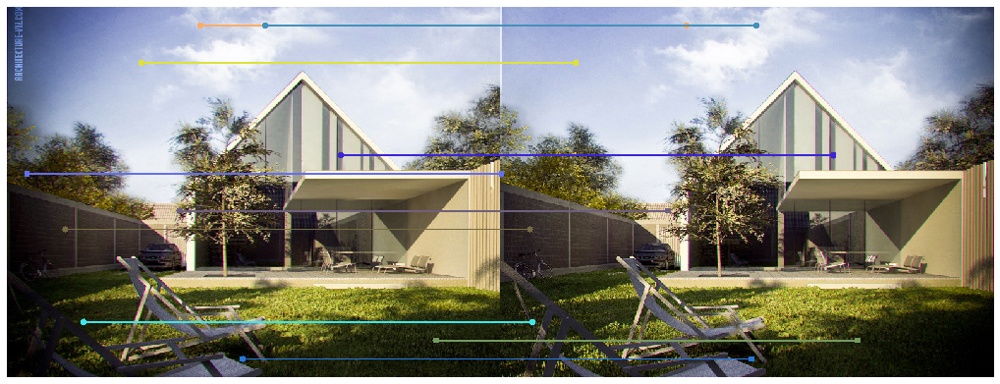

ValueError: 'a' must be greater than 0 unless no samples are taken

In [25]:
x=1
img1 = cv2.cvtColor(cv2.imread('./images/output/stereo_rect'+str(x)+'_1.jpg'),cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(cv2.imread('./images/output/stereo_rect'+str(x)+'_2.jpg'),cv2.COLOR_BGR2GRAY)
matches = np.array(dpbased_matching(img1,img2,30))
sampling = np.random.choice(matches.shape[0],10)
match_list = []
for s in sampling:
    match_list.append(matches[s])
img1 = cv2.imread('./images/output/stereo_rect'+str(x)+'_1.jpg')
img2 = cv2.imread('./images/output/stereo_rect'+str(x)+'_2.jpg')
lined_im = draw_matches(img1,img2,match_list)      

x=2
img1 = cv2.cvtColor(cv2.imread('./images/output/stereo_rect'+str(x)+'_1.jpg'),cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(cv2.imread('./images/output/stereo_rect'+str(x)+'_2.jpg'),cv2.COLOR_BGR2GRAY)
matches = np.array(dpbased_matching(img1,img2,30))
sampling = np.random.choice(matches.shape[0],10)
match_list = []
for s in sampling:
    match_list.append(matches[s])
img1 = cv2.imread('./images/output/stereo_rect'+str(x)+'_1.jpg')
img2 = cv2.imread('./images/output/stereo_rect'+str(x)+'_2.jpg')
lined_im = draw_matches(img1,img2,match_list)  

x=3
img1 = cv2.cvtColor(cv2.imread('./images/output/stereo_rect'+str(x)+'_1.jpg'),cv2.COLOR_BGR2GRAY)
img2 = cv2.cvtColor(cv2.imread('./images/output/stereo_rect'+str(x)+'_2.jpg'),cv2.COLOR_BGR2GRAY)
matches = np.array(dpbased_matching(img1,img2,30))
sampling = np.random.choice(matches.shape[0],10)
match_list = []
for s in sampling:
    match_list.append(matches[s])
img1 = cv2.imread('./images/output/stereo_rect'+str(x)+'_1.jpg')
img2 = cv2.imread('./images/output/stereo_rect'+str(x)+'_2.jpg')
lined_im = draw_matches(img1,img2,match_list)  

### Comparison between Greedy Matching and Dynamic programming solution for Stereo Correspondence on the rectified images.

Greedy algorithm does not give as good solutions as Dynamic Programming as it does not take into account occlusion 
where in least common subsequence occlusion is taken into account. Dynamic Programming based solution is based on equality between pixels where as Greedy algorithm is based on the correlation between patches so the DP algorithm will give better matches.

## Question 2 Bonus : Dense sift matching

In [27]:
def dense_sift_matching(img1,img2,step,min_match_cnt=500):
    sift = cv2.xfeatures2d.SIFT_create()
    h,w = img1.shape
    kp=[]
    for i in range(1,h,step):
        for j in range(1,w,step):
            kp.append(cv2.KeyPoint(i, j, 3))
    
    kp1,des1 = sift.compute(img1,kp)

    kp2,des2 = sift.compute(img2,kp)

    # BFMatcher with default params
    bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)
    matches = bf.match(des1,des2)
    matches = sorted(matches, key = lambda x:x.distance)[0:min_match_cnt]
    print("Found Matches:",len(matches))
    draw_params = dict(matchesMask=None,
                       singlePointColor=None,
                       flags=2)

    dis_im = cv2.drawMatches(img1,kp1,img1,kp1,matches,None,**draw_params)
    plt.figure(figsize=(16,16))
    plt.axis('off')
    plt.imshow(dis_im)
    return kp1,des1,kp2,des2,matches,dis_im

In [28]:
x = 1
img = cv2.cvtColor(cv2.imread('./images/stereo_images/'+str(x)+'.jpg'),cv2.COLOR_BGR2GRAY)
h,w = img.shape
img1 = img[:,0:w//2]
img2 = img[:,w//2:w]
x = dense_sift_matching(img1,img2,10)
x = 2
img = cv2.cvtColor(cv2.imread('./images/stereo_images/'+str(x)+'.jpg'),cv2.COLOR_BGR2GRAY)
h,w = img.shape
img1 = img[:,0:w//2]
img2 = img[:,w//2:w]
x = dense_sift_matching(img1,img2,10)
x = 3
img = cv2.cvtColor(cv2.imread('./images/stereo_images/'+str(x)+'.jpeg'),cv2.COLOR_BGR2GRAY)
h,w = img.shape
img1 = img[:,0:w//2]
img2 = img[:,w//2:w]
x = dense_sift_matching(img1,img2,10)

error: OpenCV(3.4.4) ../opencv_contrib/modules/xfeatures2d/src/sift.cpp:1205: error: (-213:The function/feature is not implemented) This algorithm is patented and is excluded in this configuration; Set OPENCV_ENABLE_NONFREE CMake option and rebuild the library in function 'create'


### Dense SIFT vs. Intensity based matching:
- Dense SIFT computes SIFT features at all possible points on a grid and computes SIFT descriptors over those. Then we use a feature matcher and pickup the best points according to how many points we require.
- Intensity based matching is a brute force approach that compares all image patches with all image patches in the other image and returns best matches.
Intensity based matching is not reliable as it takes only intensity based information into consideration, SIFT uses gradient, scale etc. SIFT based matching is much more reliable hence.